# Plot the phages in all conditions

Make the map for all the phages detected previously

In [1]:
import pandas as pd
import oligomm.contact_map_analysis as olc
import os
import numpy as np
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.patches as patches
from os.path import join

os.chdir("/data/oligomm/")

In [2]:
prophages = pd.read_csv("prophages.bed", sep="\t", header=None)

list_bacteria = [
    "acutalibacter_muris",
    "akkermansia_muciniphila",
    "bacteroidetes_caecimuris",
    "bifidobacterium_animalis",
    "blautia_coccoides",
    "clostridium_clostridioforme",
    "clostridium_innocuum",
    "enterococcus_faecalis",
    "flavonifractor_plautii",
    "lactobacillus_reuteri",
    "muribaculum_intestinale",
    "turicimonas_muris",
]

list_conditions = [
    "in_vitro_R1",
    "in_vitro_R2",
    "in_vivo_2019_R1",
    "in_vivo_2019_R2",
    "in_vivo_2020_R1",
    "in_vivo_2020_R2",
    "in_vivo_2021_R1",
    "in_vivo_2021_R2",
]

list_bacteria_vivo = [
    "akkermansia_muciniphila",
    "bacteroidetes_caecimuris",
    "blautia_coccoides",
    "clostridium_clostridioforme",
    "clostridium_innocuum",
    "muribaculum_intestinale",
]

## Example of phage map 

In [3]:
binning=5000
M = olc.build_contact_maps(["blautia_coccoides/in_vitro_R1/abs_fragments_contacts_weighted.txt"], "blautia_coccoides/in_vitro_R1/fragments_list.txt", binning)
cov = pd.read_csv("blautia_coccoides/cov/b_coccoides_in_vitro_R1_cov.bed", sep="\t", header=None)

INFO :: Note: NumExpr detected 16 cores but "NUMEXPR_MAX_THREADS" not set, so enforcing safe limit of 8.
INFO :: NumExpr defaulting to 8 threads.


In [4]:
def plot_phages(M, cov, pos, binning, outfile):
    start = max(0, (pos[0] - 50000))
    end = min(M.shape[0] * binning, (pos[1] + 50000))
    start_matrix = start // binning
    end_matrix = end // binning
    start_cov = start // 500
    end_cov = end // 500
#     print(start_matrix, end_matrix, start_cov, end_cov, start, end)
    fig, ax = plt.subplots(3, 1, figsize=(10, 14), gridspec_kw={'height_ratios' : [10, 1, 1]})
    ax[0].imshow(M[start_matrix:end_matrix, start_matrix:end_matrix], cmap="Reds",
                  vmax=np.percentile(M, 99.9))
    ax[0].get_xaxis().set_visible(False)
    ax[0].get_yaxis().set_visible(False)
    ax[1].plot(cov[1][start_cov:end_cov], cov[3][start_cov:end_cov])
    ax[1].set_xlim(start, end)
    ax[1].get_xaxis().set_visible(False)
    ax[2].scatter(np.arange(start, end + 1, end - start), np.repeat(0.5, 2), color=None)
    ax[2].add_patch(
         patches.Rectangle(
            (start, 0),
            pos[0] - start,
            1,
            edgecolor = '#1f78b4',
            facecolor = '#1f78b4',
            fill=True
         ))
    ax[2].add_patch(
         patches.Rectangle(
            (pos[0], 0),
            pos[1] - pos[0],
            1,
            edgecolor = '#e31a1c',
            facecolor = '#e31a1c',
            fill=True
         ))
    ax[2].add_patch(
         patches.Rectangle(
            (pos[1], 0),
            end - pos[1],
            1,
            edgecolor = '#1f78b4',
            facecolor = '#1f78b4',
            fill=True
         ))
    ax[2].set_xlim(start, end)
    ax[2].get_yaxis().set_visible(False)
    plt.savefig(outfile)
    #plt.close()

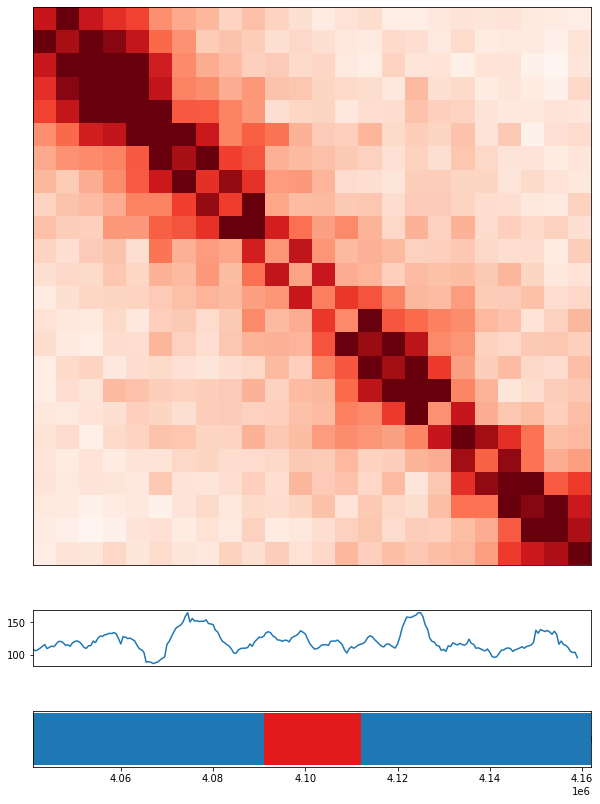

In [5]:
bac = "blautia_coccoides"
rep = "in_vitro_R1"
binning = 5000
pos=(4091000, 4112000)

os.makedirs(join("/data/oligomm/", bac, "prophages_plot"), exist_ok=True)
os.chdir(join("/data/oligomm/", bac))
    
label = '_'.join([bac.split("_")[0][0].upper(), bac.split('_')[1]])
outfile = join("prophages_plot", "_".join([label, rep, str(binning // 1000) + "kb", str(pos[0] // 1000)]) + "kb.pdf")

plot_phages(M, cov, pos, binning, outfile)

## All bacteria 2kb resolution

A_muris
A_muciniphila
B_caecimuris
B_animalis
B_coccoides
C_clostridioforme
C_innocuum
E_faecalis
F_plautii
L_reuteri
M_intestinale
T_muris


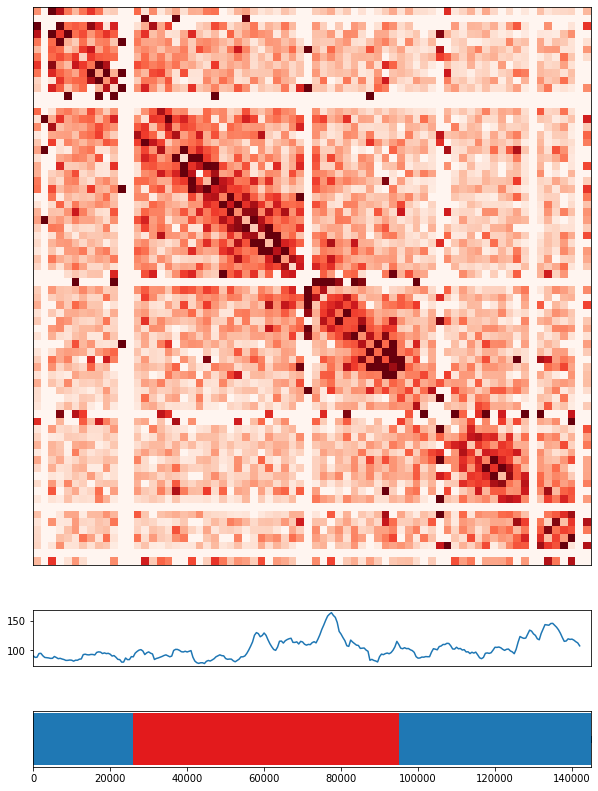

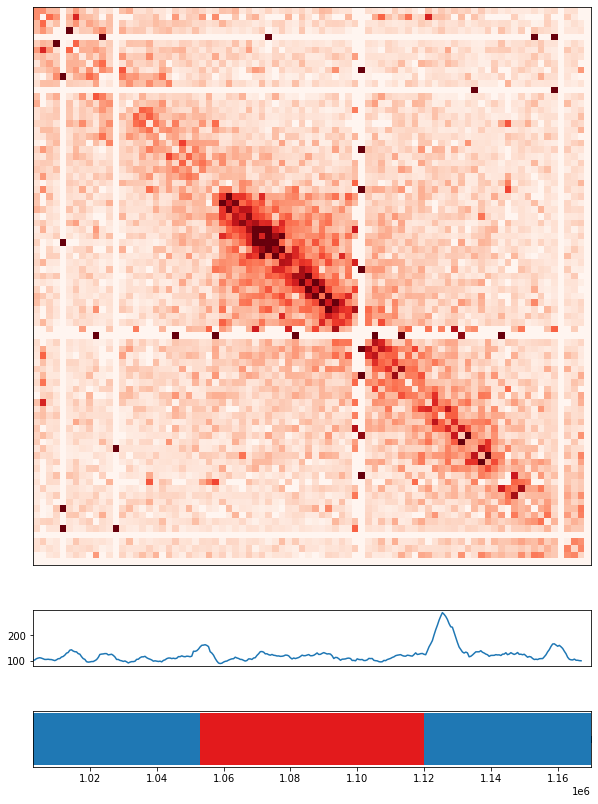

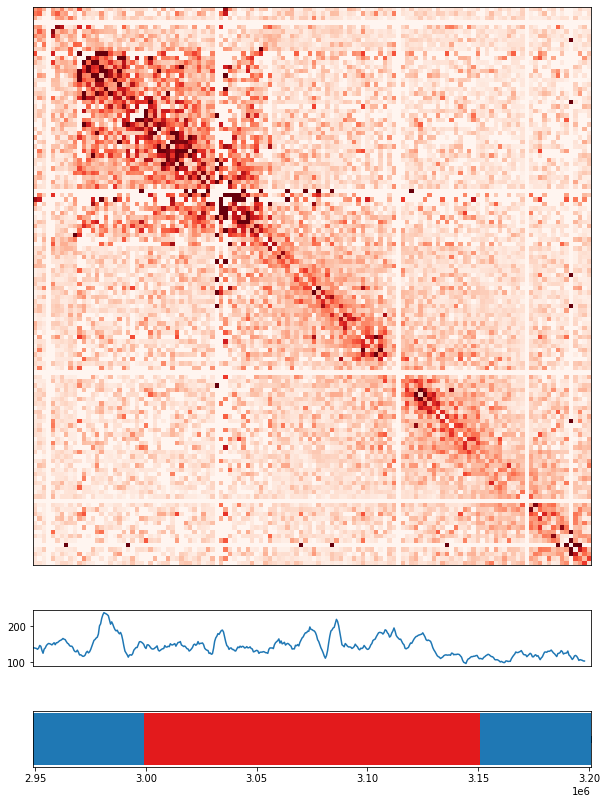

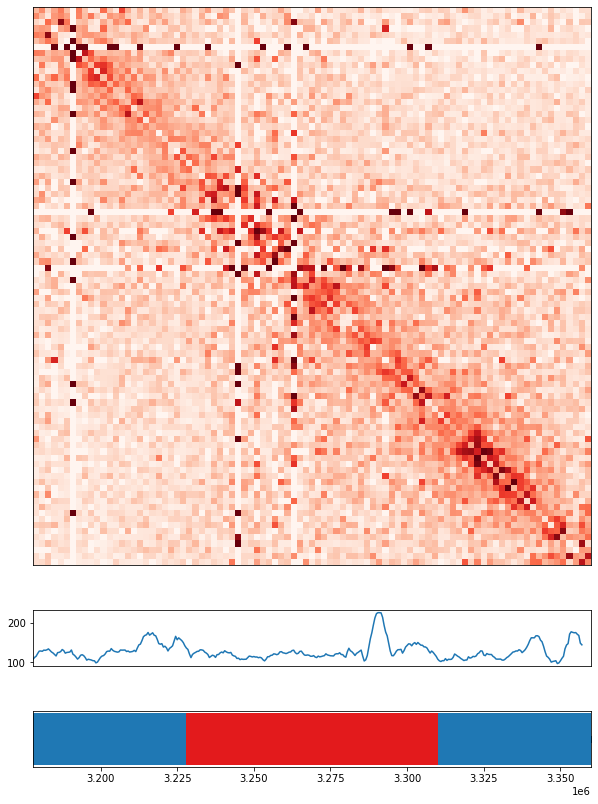

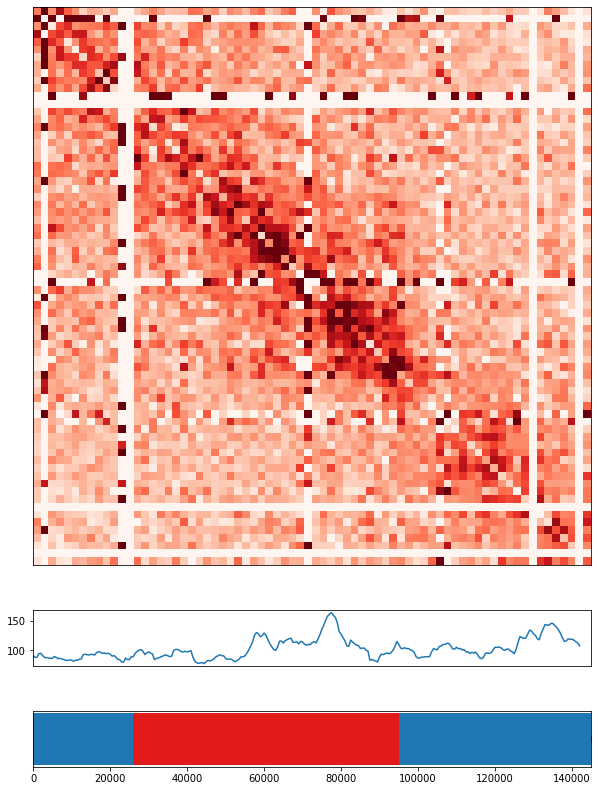

...

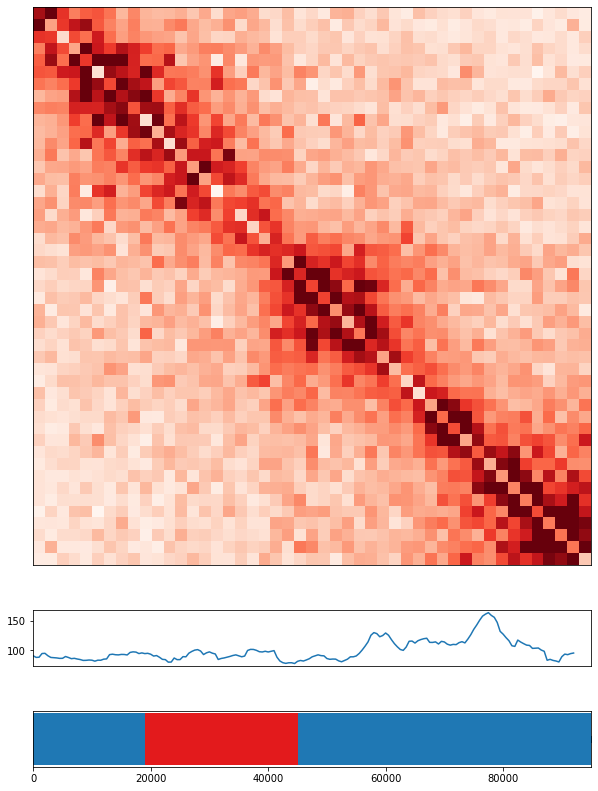

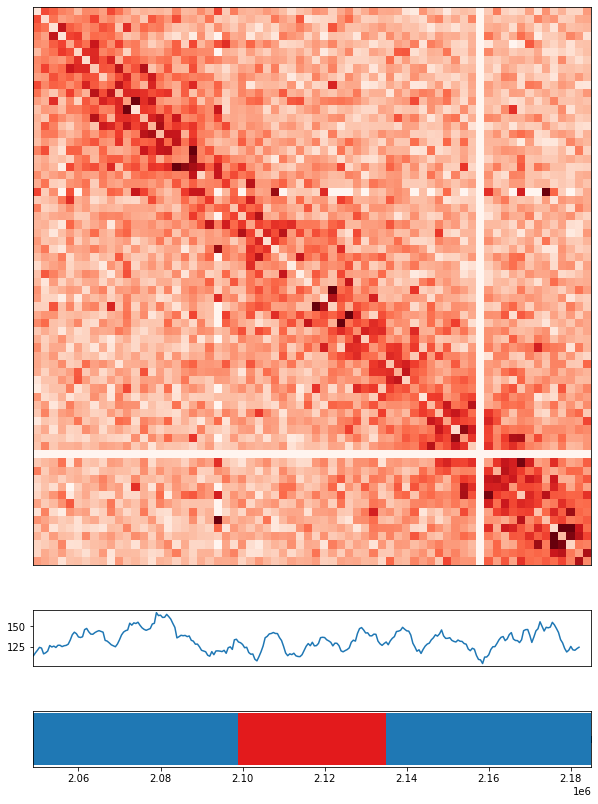

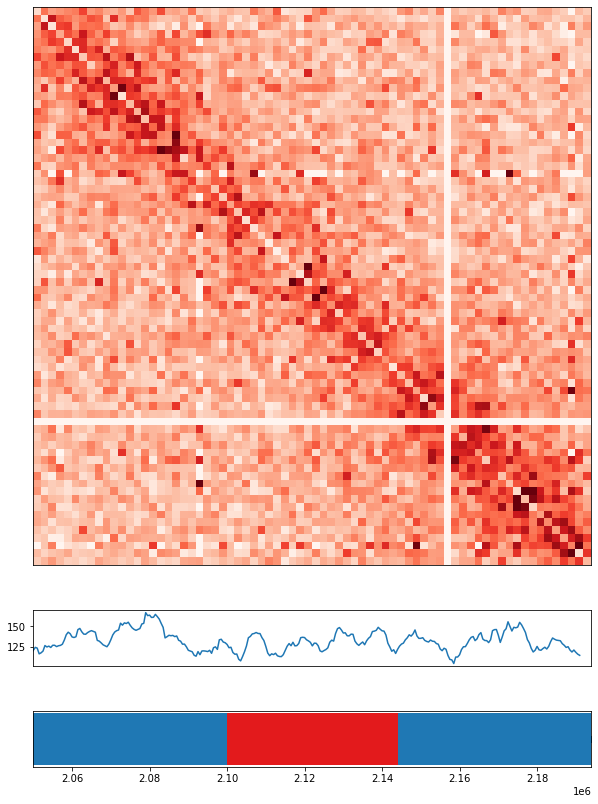

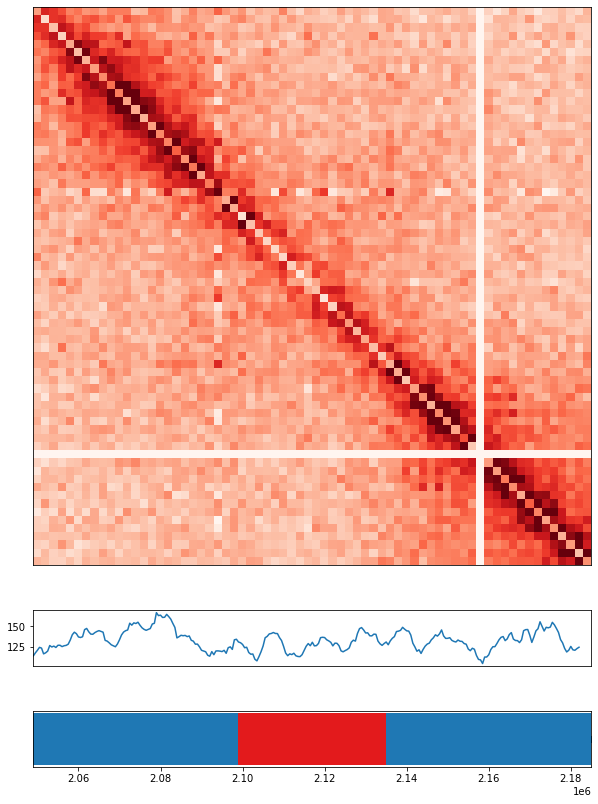

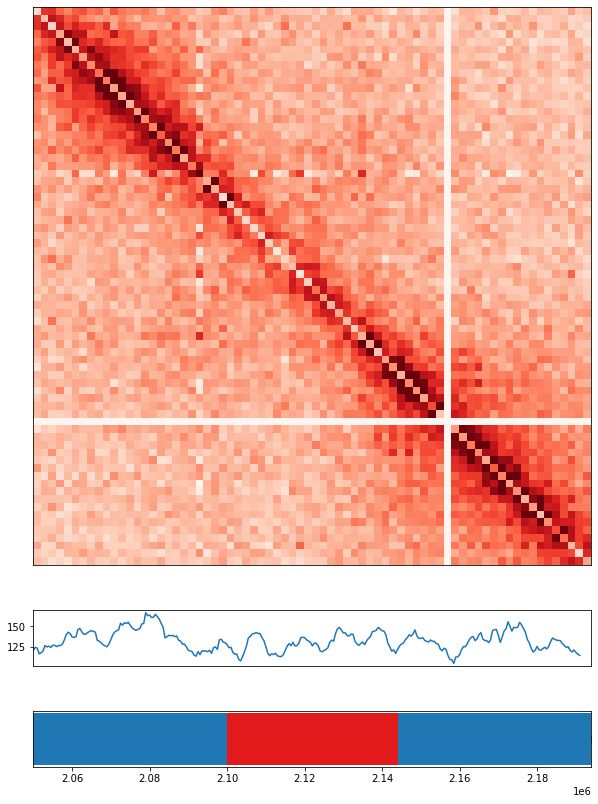

In [6]:
binning = 2000
for bac in list_bacteria:
    
    # Define label
    label = '_'.join([bac.split("_")[0][0].upper(), bac.split('_')[1]])
    print(label)
    # Define name from the prophages table.
    if bac == "clostridium_clostridioforme":
        name = bac.split('_')[1]
    else:
        name = label
        
    # Create list with positions of the prophages as tuples.
    list_pos = []
    for i, v in enumerate(prophages[0]):
        if v == name:
            list_pos.append((prophages.iloc[i, 1], prophages.iloc[i, 2]))
            
    # If some prophages plot them
    if len(list_pos) > 0:
        os.makedirs(join("/data/oligomm/", bac, "prophages_plot"), exist_ok=True)
        # Iterates on all conditions according to the bacteria coverage
        if bac in list_bacteria_vivo:
            list_conditions_bac = list_conditions
        else:
            list_conditions_bac = list_conditions[:2]
        for rep in list_conditions_bac:
            os.chdir(join("/data/oligomm/", bac, rep))
            M = olc.build_contact_maps(["abs_fragments_contacts_weighted.txt"], "fragments_list.txt", binning)
            os.chdir('..')
            cov_file = join("cov", "_".join([label.lower(), rep, "cov"]) + ".bed")
            pd.read_csv(cov_file, sep='\t', header=None)
            for pos in list_pos:
                outfile = join("prophages_plot", "_".join([label, rep, str(binning // 1000) + "kb", str(pos[0] // 1000)]) + "kb.pdf")
                plot_phages(M, cov, pos, binning, outfile)
            os.chdir("..")
    

## All bacteria 5kb resolution

A_muris
A_muciniphila
B_caecimuris
B_animalis
B_coccoides
C_clostridioforme
C_innocuum
E_faecalis
F_plautii
L_reuteri
M_intestinale
T_muris


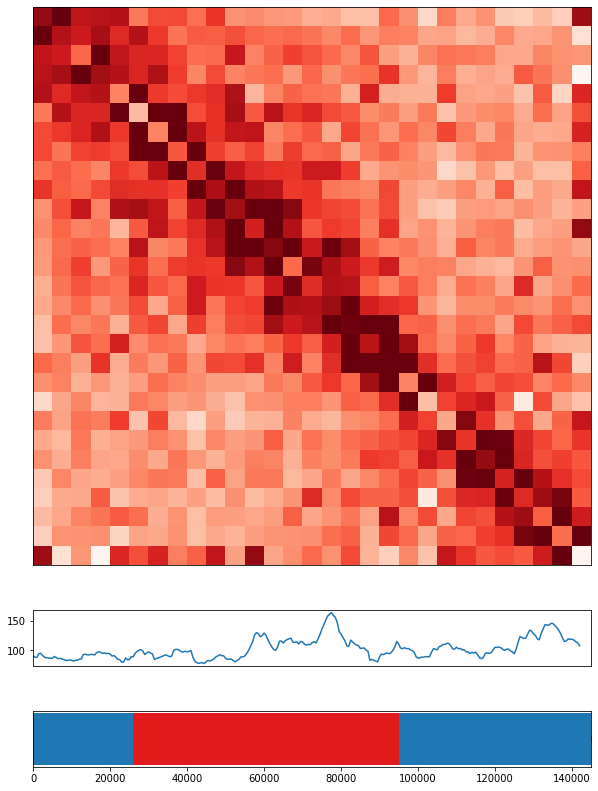

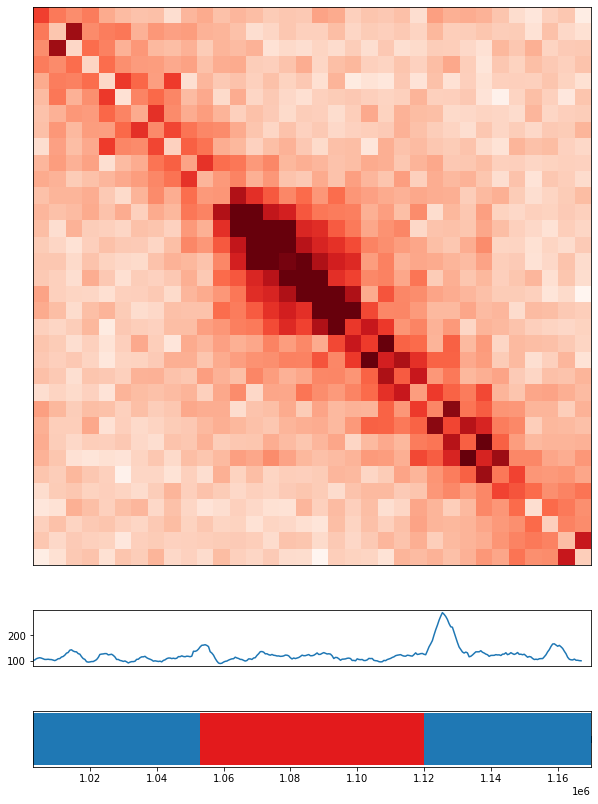

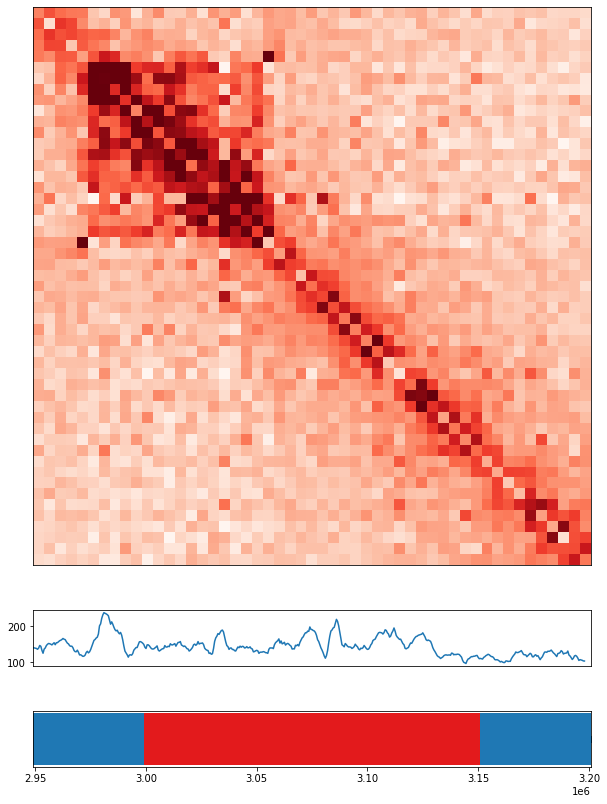

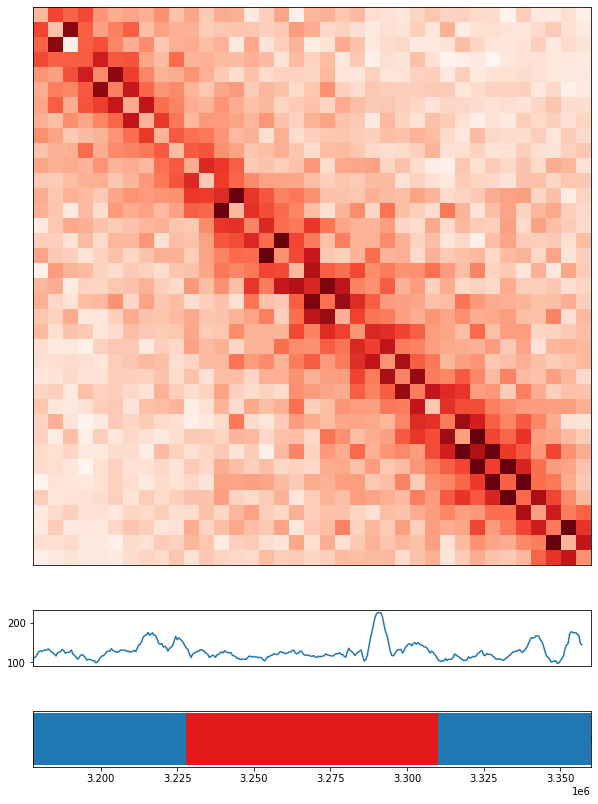

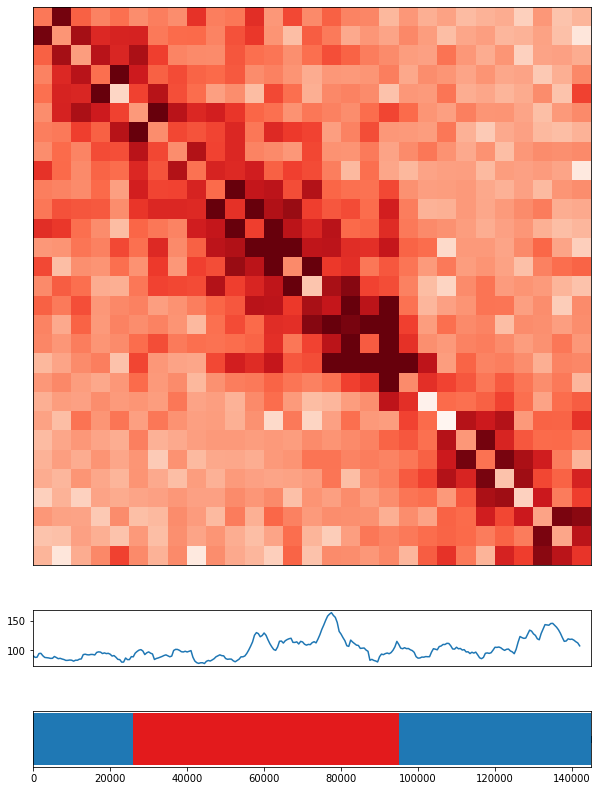

...

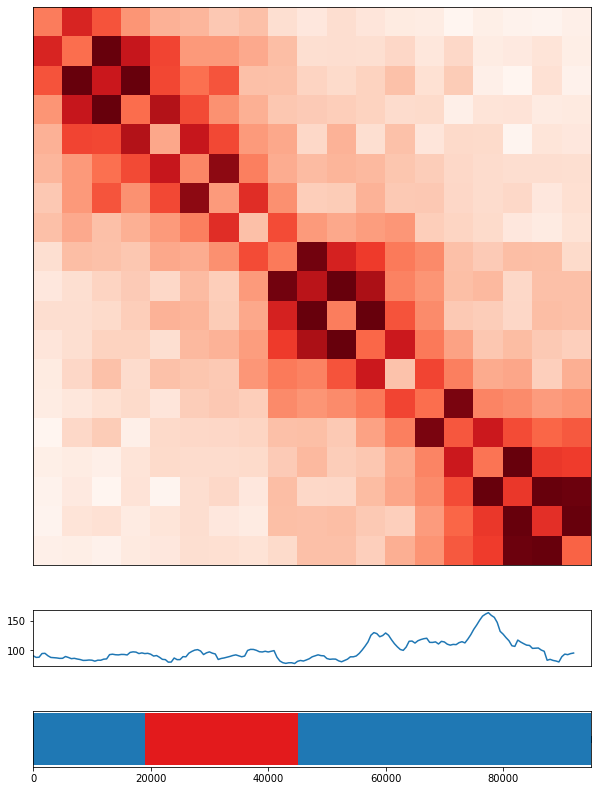

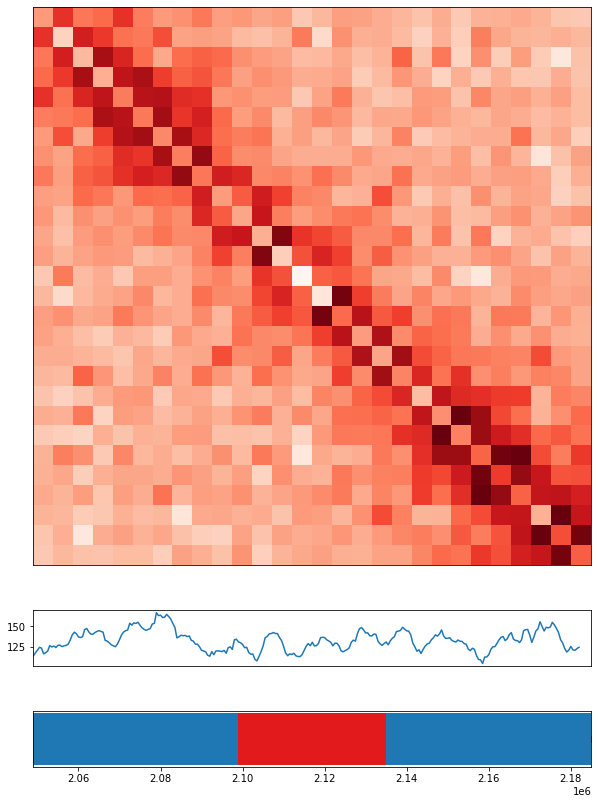

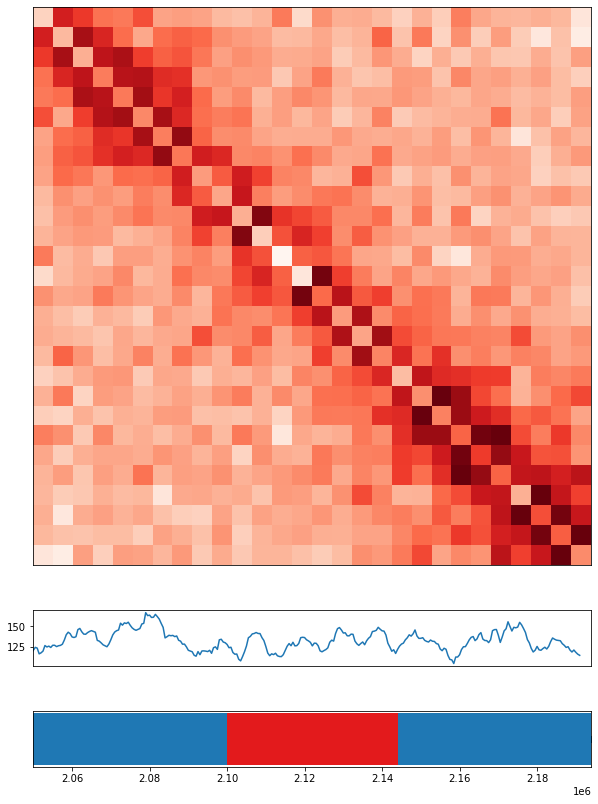

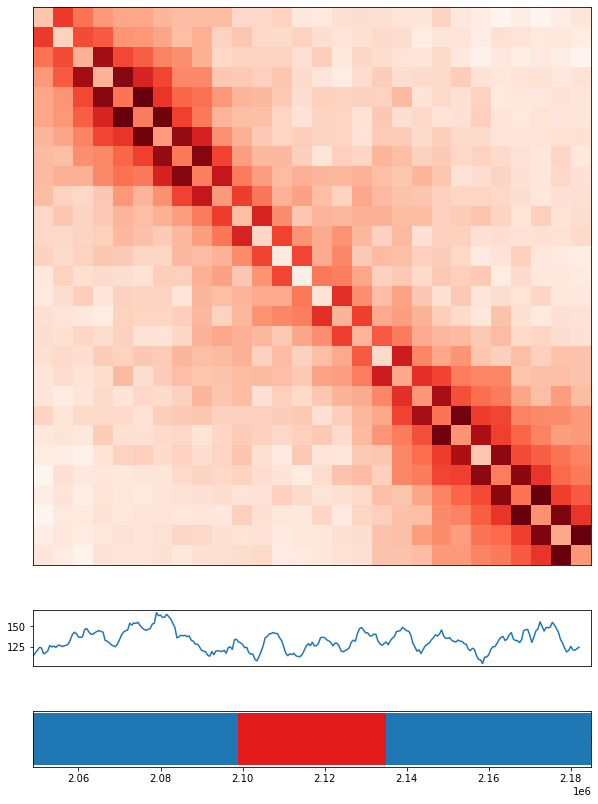

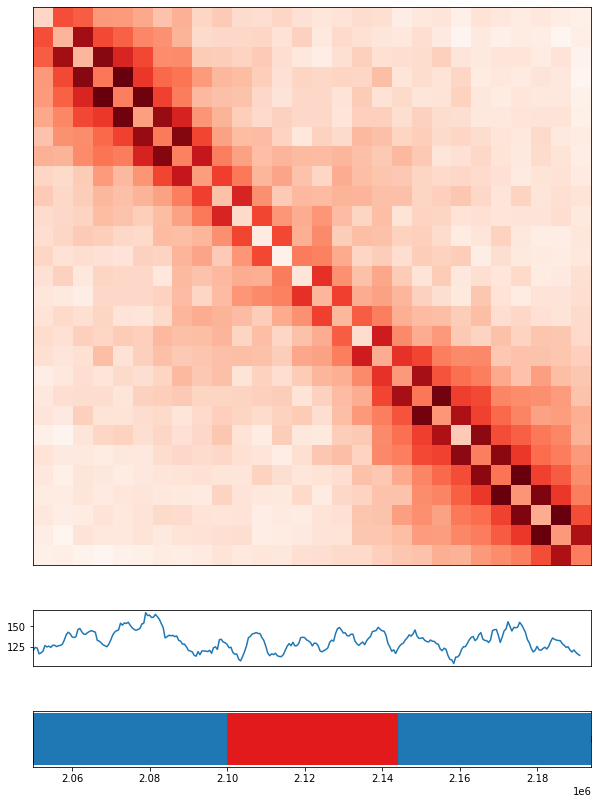

In [7]:
binning = 5000
for bac in list_bacteria:
    
    # Define label
    label = '_'.join([bac.split("_")[0][0].upper(), bac.split('_')[1]])
    print(label)
    # Define name from the prophages table.
    if bac == "clostridium_clostridioforme":
        name = bac.split('_')[1]
    else:
        name = label
        
    # Create list with positions of the prophages as tuples.
    list_pos = []
    for i, v in enumerate(prophages[0]):
        if v == name:
            list_pos.append((prophages.iloc[i, 1], prophages.iloc[i, 2]))
            
    # If some prophages plot them
    if len(list_pos) > 0:
        os.makedirs(join("/data/oligomm/", bac, "prophages_plot"), exist_ok=True)
        # Iterates on all conditions according to the bacteria coverage
        if bac in list_bacteria_vivo:
            list_conditions_bac = list_conditions
        else:
            list_conditions_bac = list_conditions[:2]
        for rep in list_conditions_bac:
            os.chdir(join("/data/oligomm/", bac, rep))
            M = olc.build_contact_maps(["abs_fragments_contacts_weighted.txt"], "fragments_list.txt", binning)
            os.chdir('..')
            cov_file = join("cov", "_".join([label.lower(), rep, "cov"]) + ".bed")
            pd.read_csv(cov_file, sep='\t', header=None)
            for pos in list_pos:
                outfile = join("prophages_plot", "_".join([label, rep, str(binning // 1000) + "kb", str(pos[0] // 1000)]) + "kb.pdf")
                plot_phages(M, cov, pos, binning, outfile)
            os.chdir("..")
    